# Assignment 3. Data Visualization  

*Principles and Techniques of Data Science*  
*Dr. Fazli (Fall 2023)*  

*For your questions refer to parishadmokhber79@gmail.com or @prdmk on Telegram*

### Description
We are starting our data visualization studies with a project about analyzing COVID-19 data. In this assignment, we will be studying the COVID-19 pandemic data from different countries around the world. We have tried to show the assignment details one by one below.  We hope you enjoy this adventure.

# 1
You have to apply the following Data Wrangling pipeline:
* Load your data   
* Explore it and clean its dirty parts and change it in an appropriate value
* Use it to answer a set of queries

Each of these subtasks are described in detail below.

### Library
First, we will get the libraries we need.

In [ ]:
!pip install folium
!pip install plotly
!pip install squarify
!pip install geopandas

### Import Libraries

In [ ]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
import squarify
import seaborn as sns
from tabulate import tabulate
import geopandas as gpd
import folium
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

import math
import random
from datetime import timedelta

import warnings
warnings.filterwarnings('ignore')

#color pallette
cnf = '#393e46'
dth = '#ff2e63'
rec = '#21bf73'
act = '#fe9801'

### Loading phase
After we brought in our libraries, load all the csv files into different `DataFrames`. Use meaningful names for your `DataFrames` (e.g., the respective filenames).

In [ ]:
df = pd.read_csv('world data/covid_19_data_cleaned.csv',parse_dates=['Date'])
country_daywise = pd.read_csv('world data/country_daywise.csv',parse_dates=['Date'])
countrywise = pd.read_csv('world data/countrywise.csv')
daywise = pd.read_csv('world data/daywise.csv',parse_dates=['Date'])

### Cleaning phase
Extract the information and description from the data and if necessary, fill the missing data with the appropriate value or delete it and drop the columns with irrelevant data, and then explain what you notice from each data column. (Some important columns are marked with zero, you are expected to insert this value with columns that have this value).

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 210496 entries, 0 to 210495
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Date            210496 non-null  datetime64[ns]
 1   Province/State  65504 non-null   object        
 2   Country         210496 non-null  object        
 3   Lat             210496 non-null  float64       
 4   Long            210496 non-null  float64       
 5   Confirmed       210496 non-null  int64         
 6   Recovered       210496 non-null  int64         
 7   Deaths          210496 non-null  int64         
 8   Active          210496 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(4), object(2)
memory usage: 14.5+ MB


In [ ]:
df

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,NaN,Afghanistan,33.93911,67.709953,0,0,0,0
1,2020-01-23,NaN,Afghanistan,33.93911,67.709953,0,0,0,0
2,2020-01-24,NaN,Afghanistan,33.93911,67.709953,0,0,0,0
3,2020-01-25,NaN,Afghanistan,33.93911,67.709953,0,0,0,0
4,2020-01-26,NaN,Afghanistan,33.93911,67.709953,0,0,0,0
...,...,...,...,...,...,...,...,...,...
210491,2022-01-22,NaN,Timor-Leste,-8.87420,125.727500,0,0,0,0
210492,2022-01-23,NaN,Timor-Leste,-8.87420,125.727500,0,0,0,0
210493,2022-01-24,NaN,Timor-Leste,-8.87420,125.727500,0,0,0,0
210494,2022-01-25,NaN,Timor-Leste,-8.87420,125.727500,0,0,0,0


In [ ]:
df['Province/State'] = df['Province/State'].fillna("")
df.head()

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,,Afghanistan,33.93911,67.709953,0,0,0,0
1,2020-01-23,,Afghanistan,33.93911,67.709953,0,0,0,0
2,2020-01-24,,Afghanistan,33.93911,67.709953,0,0,0,0
3,2020-01-25,,Afghanistan,33.93911,67.709953,0,0,0,0
4,2020-01-26,,Afghanistan,33.93911,67.709953,0,0,0,0


In [ ]:
country_daywise.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 143668 entries, 0 to 143667
Data columns (total 9 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Date           143668 non-null  datetime64[ns]
 1   Country        143668 non-null  object        
 2   Confirmed      143668 non-null  int64         
 3   Deaths         143668 non-null  int64         
 4   Recovered      143668 non-null  int64         
 5   Active         143668 non-null  int64         
 6   New Cases      143668 non-null  int64         
 7   New Recovered  143668 non-null  int64         
 8   New Deaths     143668 non-null  int64         
dtypes: datetime64[ns](1), int64(7), object(1)
memory usage: 9.9+ MB


In [ ]:
country_daywise

,Date,Country,Confirmed,Deaths,Recovered,Active,New Cases,New Recovered,New Deaths
0,2020-01-23,Afghanistan,0,0,0,0,0,0,0
1,2020-01-24,Afghanistan,0,0,0,0,0,0,0
2,2020-01-25,Afghanistan,0,0,0,0,0,0,0
3,2020-01-26,Afghanistan,0,0,0,0,0,0,0
4,2020-01-27,Afghanistan,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...
143663,2022-01-20,Zimbabwe,227552,5276,0,222276,665,0,10
143664,2022-01-21,Zimbabwe,227961,5288,0,222673,409,0,12
143665,2022-01-22,Zimbabwe,228179,5292,0,222887,218,0,4
143666,2022-01-23,Zimbabwe,228254,5294,0,222960,75,0,2


In [ ]:
countrywise.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 196 entries, 0 to 195
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Country                 196 non-null    object 
 1   Confirmed               196 non-null    int64  
 2   Deaths                  196 non-null    int64  
 3   Recovered               196 non-null    int64  
 4   Active                  196 non-null    int64  
 5   New Cases               196 non-null    int64  
 6   Deaths / 100 Cases      196 non-null    float64
 7   Recovered / 100 Cases   196 non-null    float64
 8   Deaths / 100 Recovered  196 non-null    float64
 9   Population              196 non-null    int64  
 10  Cases / Million People  196 non-null    float64
 11  Confirmed last week     196 non-null    int64  
 12  1 week change           196 non-null    int64  
 13  1 week % increase       196 non-null    float64
dtypes: float64(5), int64(8), object(1)
memory 

In [ ]:
countrywise

,Country,Confirmed,Deaths,Recovered,Active,New Cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Population,Cases / Million People,Confirmed last week,1 week change,1 week % increase
0,Afghanistan,159896,7393,0,152503,247,4.62,0.0,0.0,38928341,4107.0,158826,1070,0.67
1,Albania,248070,3305,0,244765,0,1.33,0.0,0.0,2877800,86201.0,233654,14416,6.17
2,Algeria,238885,6508,0,232377,2215,2.72,0.0,0.0,43851043,5448.0,226749,12136,5.35
3,Andorra,33025,144,0,32881,0,0.44,0.0,0.0,77265,427425.0,29888,3137,10.50
4,Angola,97263,1888,0,95375,681,1.94,0.0,0.0,32866268,2959.0,93974,3289,3.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
191,Vietnam,2155784,36884,0,2118900,14362,1.71,0.0,0.0,97338583,22147.0,2023546,132238,6.53
192,West Bank and Gaza,484979,5056,0,479923,4396,1.04,0.0,0.0,4543126,106750.0,476328,8651,1.82
193,Yemen,10585,1995,0,8590,0,18.85,0.0,0.0,29825968,355.0,10352,233,2.25
194,Zambia,301924,3900,0,298024,294,1.29,0.0,0.0,18383956,16423.0,296817,5107,1.72


In [ ]:
daywise.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 733 entries, 0 to 732
Data columns (total 10 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   Date                    733 non-null    datetime64[ns]
 1   Confirmed               733 non-null    int64         
 2   Deaths                  733 non-null    int64         
 3   Recovered               733 non-null    int64         
 4   Active                  733 non-null    int64         
 5   New Cases               733 non-null    int64         
 6   Deaths / 100 Cases      733 non-null    float64       
 7   Recovered / 100 Cases   733 non-null    float64       
 8   Deaths / 100 Recovered  733 non-null    float64       
 9   No. of Countries        733 non-null    int64         
dtypes: datetime64[ns](1), float64(3), int64(6)
memory usage: 57.4 KB


In [ ]:
daywise

,Date,Confirmed,Deaths,Recovered,Active,New Cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,No. of Countries
0,2020-01-23,655,18,32,605,99,2.75,4.89,56.25,8
1,2020-01-24,941,26,39,876,288,2.76,4.14,66.67,9
2,2020-01-25,1434,42,42,1350,495,2.93,2.93,100.00,11
3,2020-01-26,2118,56,56,2006,684,2.64,2.64,100.00,13
4,2020-01-27,2927,82,65,2780,809,2.80,2.22,126.15,16
...,...,...,...,...,...,...,...,...,...,...
728,2022-01-20,342640759,5576626,0,337064133,3638326,1.63,0.00,inf,196
729,2022-01-21,346460584,5586325,0,340874259,3819825,1.61,0.00,inf,196
730,2022-01-22,349129702,5592206,0,343537496,2669118,1.60,0.00,inf,196
731,2022-01-23,351523268,5597006,0,345926262,2393566,1.59,0.00,inf,196


Using the data from the <code>covid_19_data_cleaned</code>, find the <code>confirmed</code>, <code>recovered</code>, and  <code>deaths</code> cases to verify the results in the <code>daywise</code> dataframe.

In [ ]:
confirmed = df.groupby('Date').sum()['Confirmed'].reset_index()
recovered = df.groupby('Date').sum()['Recovered'].reset_index()
deaths = df.groupby('Date').sum()['Deaths'].reset_index()

# Visualization
#### Now show the total number of confirmed, recovered and dead covid-19 patients in the world across the time with suitable figures individually and also explain the reason for choosing the figures you have chosen.

***NOTE***: You can choose to plot the results with <code>matplotlib</code> or <code>plotly</code> libraries, but the more interactive your figures are, the more points you will receive.

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = confirmed['Date'], y = confirmed['Confirmed'], mode = 'lines+markers', name = 'Confirmed', line = dict(color = "purple", width = 1)))
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = recovered['Date'], y = recovered['Recovered'], mode = 'lines+markers', name = 'Recovered', line = dict(color = "Green", width = 1)))
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = deaths['Date'], y = deaths['Deaths'], mode = 'lines+markers', name = 'Deaths', line = dict(color = "Red", width = 1)))
fig.show()

#### Now show all the total number of confirmed, recovered and dead covid-19 patients across the time in one figure. Explain what you can understand from the plot.

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = confirmed['Date'], y = confirmed['Confirmed'], mode = 'lines+markers', name = 'Confirmed', line = dict(color = "Black", width = 1)))
fig.add_trace(go.Scatter(x = recovered['Date'], y = recovered['Recovered'], mode = 'lines+markers', name = 'Recovered', line = dict(color = "Green", width = 1)))
fig.add_trace(go.Scatter(x = deaths['Date'], y = deaths['Deaths'], mode = 'lines+markers', name = 'Deaths', line = dict(color = "Red", width = 1)))
fig.update_layout(title = 'Worldwide Covid-19 Cases', xaxis_tickfont_size = 14, yaxis = dict(title = 'Number of Cases'))
fig.show()

#### Why the graph of recoveries has a sharp decline after a specific date? Find this date as well.

#### Plot the recovered, deaths, and active cases over time with an area plot. You can use <code>px.area</code> or <code>px.bar</code> to visualize these plots.

***NOTE***: The more interactive your figures are, the more points you will receive. Consider having a slidebar which can be modified to show the area in a specific period of time.

In [ ]:
temp = df.groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
temp = df.melt(id_vars = 'Date', value_vars = ['Recovered', 'Deaths', 'Active'], var_name = 'Case', value_name = 'Count')
fig = px.area(temp, x = 'Date', y = 'Count', color = 'Case', height = 600, title = 'Cases over time', color_discrete_sequence=[rec, dth, act])

fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

## Confirmed Cases with Choropleth Map

Now use <code>px.choropleth</code> to plot a Choropleth Map over time for the confirmed and death cases from the <code>country_daywise</code> data frame.

In [ ]:
fig = px.choropleth(country_daywise, locations= 'Country', locationmode='country names', color = country_daywise['Confirmed'],
                   hover_name = 'Country', animation_frame=country_daywise['Date'].dt.strftime('%Y-%m-%d'),
                   title='Cases over time', color_continuous_scale=px.colors.sequential.Inferno)
fig.update(layout_coloraxis_showscale = True)
fig.show()

### Confirmed and Death Cases with Static Colormap

Now plot the choropleth figures for confirmed and death cases, but only use a single date to have a static visualization.

In [ ]:
fig_c = px.choropleth(countrywise, locations='Country',locationmode='country names',
                     color = np.log(countrywise['Confirmed']), hover_name = 'Country',
                     hover_data = ['Confirmed'])
temp= countrywise[countrywise['Deaths']>0]
fig_d = px.choropleth(temp, locations='Country',locationmode='country names',
                     color = np.log(temp['Deaths']), hover_name = 'Country',
                     hover_data = ['Deaths'])

fig = make_subplots(rows = 1, cols = 2, subplot_titles= ['Confirmed','Deaths'],
                   specs = [[{'type': 'choropleth'},{'type':'choropleth'}]])

fig.add_trace(fig_c['data'][0], row = 1, col = 1)
fig.add_trace(fig_d['data'][0], row = 1, col = 2)

fig.show()

## Per 100 Cases

#### Now plot the <code>Deaths / 100 Cases</code>, <code>Recovered / 100 Cases</code>,  and <code>Deaths / 100 Recovered</code> figures with a line plot over time.

In [ ]:
fig1 = px.line(daywise, x = 'Date', y = 'Deaths / 100 Cases', color_discrete_sequence=[dth])
fig2 = px.line(daywise, x = 'Date', y = 'Recovered / 100 Cases', color_discrete_sequence=[rec])
fig3 = px.line(daywise, x = 'Date', y = 'Deaths / 100 Recovered', color_discrete_sequence=[dth])

fig = make_subplots(rows = 1, cols = 3, shared_xaxes=False,
                   subplot_titles=('Deaths / 100 Cases', 'Recovered / 100 Cases','Deaths / 100 Recovered'))

fig.add_trace(fig1['data'][0], row = 1, col = 1)
fig.add_trace(fig2['data'][0], row = 1, col = 2)
fig.add_trace(fig3['data'][0], row = 1, col = 3)

fig.update_layout(height = 500)
fig.show()

## tree map analysis

#### Now plot the <code>Confirmed Cases</code> and <code>Deaths Cases</code> figures with a tree map only use a single date to have a static visualization.

In [ ]:
full_latest = df[df['Date'] == max (df['Date'])]


fig = px.treemap(full_latest.sort_values(by = 'Confirmed', ascending = False).reset_index(drop = True),
                 path = ['Country', 'Province/State'], values = 'Confirmed', height = 700,
                 title = 'Number of Confirmed Cases',
                  color_discrete_sequence = px.colors.qualitative.Dark2)

fig.data[0].textinfo = 'label+text+value'
fig.show()

In [ ]:
full_latest = df[df['Date'] == max(df['Date'])]

fig = px.treemap(full_latest.sort_values(by = 'Deaths', ascending = False).reset_index(drop = True),
                 path = ['Country', 'Province/State'], values = 'Deaths', height = 700,
                 title = 'Number of Deaths Cases',
                  color_discrete_sequence = px.colors.qualitative.Dark2)

fig.data[0].textinfo = 'label+text+value'
fig.show()

## Covid-19 vs Other Similar Epidemics

#### Diseases can spread to humans from many different sources, from bacteria spread through flea bites to viruses that jump from animals to humans.The sources for 5 major pandemics include:
1. 1918 and 2009 influenza (H1N1): zoonotic influenza virus from pigs in 1918 and 2009.
2. COVID-19: a zoonotic coronavirus of unconfirmed origin as of March 2020. Most researchers believe it stemmed from a bat source with possible intermediate species (perhaps pangolins).
3. Ebola: zoonotic Ebola virus from a bat
4. MERS-CoV: zoonotic coronavirus possibly originally from a bat, transmitted to humans via dromedary camels
5. SARS-CoV: zoonotic coronavirus from a bat

#### It can be difficult to make direct comparisons between pandemics as they all develop within specific circumstances, from the differing nature of the disease itself to the variable social and political contexts in which the pandemic develops but in this part we try to make a Comparing pandemics by the the information that we give to you and you are expected to make a <code>dataframe</code> with these informations:

***Note1***: Extract <code>COVID-19</code> information from the data and add it to the <code>epidemics</code> dataframe.

***Note2***: Calculate the <code>Mortality</code> for all epidemics and add it to the <code>epidemics</code> dataframe.

In [ ]:
epidemics ={

    'epidemic' :  ['SARS', 'EBOLA',  'MERS', 'H1N1'],
    'start_year' :[2002,2013,2012,2009],
    'end_year' :  [2004,2016,2020,2010],
    'Confirmed' : [8422,28646,2519,6724149],
    'Deaths' :    [813,1323,866,19654]
            }


In [ ]:
epidemics = pd.DataFrame({

    'epidemic' : ['COVID-19', 'SARS', 'EBOLA',  'MERS', 'H1N1'],
    'start_year' : [2019,2002,2013,2012,2009],
    'end_year' : [2020, 2004,2016,2020,2010],
    'Confirmed' : [full_latest['Confirmed'].sum(),8422,28646,2519,6724149],
    'Deaths' : [full_latest['Deaths'].sum(),813,1323,866,19654]
})

epidemics['mortality'] = round((epidemics['Deaths']/epidemics['Confirmed'])*100,2)

epidemics.head()

,epidemic,start_year,end_year,Confirmed,Deaths,mortality
0,COVID-19,2019,2020,362130423,5626091,1.55
1,SARS,2002,2004,8422,813,9.65
2,EBOLA,2013,2016,28646,1323,4.62
3,MERS,2012,2020,2519,866,34.38
4,H1N1,2009,2010,6724149,19654,0.29


#### Now plot the Confirmed, Deaths, and Mortality figures using the information in <code>epidemics</code> to compare these pandemics. Explain what you can understand from the plot.

***Note***: You can choose to plot the <code>epidemics</code> dataframe with <code>px.bar</code> or other libraries.

In [ ]:
temp = epidemics.melt(id_vars = 'epidemic', value_vars=['Confirmed', 'Deaths','mortality'],
                     var_name = 'Case', value_name = 'Value')

fig = px.bar(temp, x = 'epidemic', y= 'Value', color = 'epidemic', text = 'Value', facet_col = 'Case',
            color_discrete_sequence=px.colors.qualitative.Bold)


fig.update_traces(textposition = 'outside')
fig.update_layout(uniformtext_minsize = 8, uniformtext_mode = 'hide')
fig.update_yaxes(showticklabels = False)
fig.layout.yaxis2.update(matches = None)
fig.layout.yaxis3.update(matches = None)
fig.show()

# Special Case: Brazil

#### After examining the covid disease globally, we want to specifically examine this Epidemic in Brazil.

### Loading phase
Load <code>cases-brazil</code> into different DataFrames. Use meaningful names for your DataFrames (e.g., the respective filenames).

In [ ]:
df = pd.read_csv("world data/cases-brazil.csv", delimiter=",")
df.head()

,country,state,city,ibgeID,deaths,totalCases,deaths_per_100k_inhabitants,totalCases_per_100k_inhabitants,deaths_by_totalCases,_source,date,newCases,newDeaths,last_info_date
0,Brazil,GO,Abadia de Goi�s/GO,5200050,50,4074,545.97074,44485.69557,0.01227,MS,2023-03-18,5,0,2023-03-18
1,Brazil,MG,Abadia dos Dourados/MG,3100104,21,1943,299.06010,27670.17944,0.01081,MS,2023-03-18,0,0,2023-03-18
2,Brazil,GO,Abadi�nia/GO,5200100,55,2218,263.49830,10626.16778,0.02480,MS,2023-03-18,-1,0,2023-03-18
3,Brazil,PA,Abaetetuba/PA,1500107,244,12009,152.08272,7485.08779,0.02032,MS,2023-03-18,13,0,2023-03-18
4,Brazil,MG,Abaet�/MG,3100203,51,4279,219.23226,18394.01625,0.01192,MS,2023-03-18,0,0,2023-03-18


### Cleaning phase
To clean the data, do the same things as you did to clean the data in the previous phase.

***Note***: Drop the columns with irrelevant data.

In [ ]:
# In[ ] Data Wragling
# Drop the columns with irrelevant data
columns_to_remove = ['country', 'city', 'ibgeID', '_source', 'newCases', 'newDeaths']
df = df.drop(columns_to_remove, axis=1)

#### In this section, we have two dictionaries, one for the states and their full names, and the other for the region and places that include each region. Create two separate new dataframes  with information related to the <code>cases-brazil</code>  with these two dictionaries.

***Note1***: Two dictionaries are provided to you in the bottom part.

***Note2***: Create a DataFrames from the dictionaries.

In [ ]:
state_names = {
    'AC': 'Acre',
    'AL': 'Alagoas',
    'AP': 'Amap�',
    'AM': 'Amazonas',
    'BA': 'Bahia',
    'CE': 'Cear�',
    'ES': 'Esp�rito Santo',
    'GO': 'Goi�s',
    'MA': 'Maranh�o',
    'MT': 'Mato Grosso',
    'MS': 'Mato Grosso do Sul',
    'MG': 'Minas Gerais',
    'PA': 'Par�',
    'PB': 'Para�ba',
    'PR': 'Paran�',
    'PE': 'Pernambuco',
    'PI': 'Piau�',
    'RJ': 'Rio de Janeiro',
    'RN': 'Rio Grande do Norte',
    'RS': 'Rio Grande do Sul',
    'RO': 'Rond�nia',
    'RR': 'Roraima',
    'SC': 'Santa Catarina',
    'SP': 'S�o Paulo',
    'SE': 'Sergipe',
    'TO': 'Tocantins',
    'DF': 'Distrito Federal'
}

regions = {
    'Regi�o Centro-Oeste': ['Goi�s', 'Mato Grosso', 'Mato Grosso do Sul'],
    'Regi�o Nordeste': ['Alagoas', 'Bahia', 'Cear�', 'Maranh�o', 'Para�ba', 'Pernambuco', 'Piau�', 'Rio Grande do Norte', 'Sergipe'],
    'Regi�o Norte': ['Acre', 'Amap�', 'Amazonas', 'Par�', 'Rond�nia', 'Roraima', 'Tocantins'],
    'Regi�o Sudeste': ['Esp�rito Santo', 'Minas Gerais', 'Rio de Janeiro', 'S�o Paulo'],
    'Regi�o Sul': ['Paran�', 'Rio Grande do Sul', 'Santa Catarina']
}


In [ ]:
# In[ ] Data Wragling
# Drop the columns with irrelevant data
columns_to_remove = ['country', 'city', 'ibgeID', '_source', 'newCases', 'newDeaths']
#df = df.drop(columns_to_remove, axis=1)

# List of states
states = ['AC', 'AL', 'AP', 'AM', 'BA',
          'CE', 'ES', 'GO', 'MA', 'MT',
          'MS', 'MG', 'PA', 'PB', 'PR',
          'PE', 'PI', 'RJ', 'RN', 'RS',
          'RO', 'RR', 'SC', 'SP', 'SE',
          'TO', 'DF']

# Create a dictionary to store state groups
state_groups = {}

# Group the data by state
for state in states:
    state_group = df[df['state'] == state]
    state_sum = state_group.sum(numeric_only=True)
    state_groups[state] = state_sum

# Create a DataFrame from the dictionary
df_by_state = pd.DataFrame.from_dict(state_groups, orient='index')

# Renaming the index column
df_by_state.index.name = 'states'

# Reset the index to numbers
df_by_state.reset_index(level=0, inplace=True)
df_by_state.rename(columns={'index': 'numbers'}, inplace=True)

# Dictionary mapping state abbreviations to full names
state_names = {
    'AC': 'Acre',
    'AL': 'Alagoas',
    'AP': 'Amap�',
    'AM': 'Amazonas',
    'BA': 'Bahia',
    'CE': 'Cear�',
    'ES': 'Esp�rito Santo',
    'GO': 'Goi�s',
    'MA': 'Maranh�o',
    'MT': 'Mato Grosso',
    'MS': 'Mato Grosso do Sul',
    'MG': 'Minas Gerais',
    'PA': 'Par�',
    'PB': 'Para�ba',
    'PR': 'Paran�',
    'PE': 'Pernambuco',
    'PI': 'Piau�',
    'RJ': 'Rio de Janeiro',
    'RN': 'Rio Grande do Norte',
    'RS': 'Rio Grande do Sul',
    'RO': 'Rond�nia',
    'RR': 'Roraima',
    'SC': 'Santa Catarina',
    'SP': 'S�o Paulo',
    'SE': 'Sergipe',
    'TO': 'Tocantins',
    'DF': 'Distrito Federal'
}

# Add a new column with full state names
df_by_state.insert(1, 'state_names', df_by_state['states'].map(state_names))

# Rename the columns
df_by_state.rename(columns={'states': 'States',
                            'state_names': 'State Names',
                            'deaths': 'Deaths',
                            'totalCases': 'Total Cases',
                            'deaths_per_100k_inhabitants': 'Deaths per 100k Inhabitants',
                            'totalCases_per_100k_inhabitants': 'Total Cases per 100k Inhabitants',
                            'deaths_by_totalCases': 'Deaths by Total Cases'},
                   inplace=True)

df_by_state.head()

# In[ ] Importing Data and Data Wragling

df1 = pd.read_csv("world data/cases-brazil.csv", delimiter=",")
df1.head()

# Drop the columns with irrelevant data
columns_to_remove = ['country', 'city', 'ibgeID', '_source', 'newCases', 'newDeaths']
#df1 = df1.drop(columns_to_remove, axis=1)

# List of states
states = ['AC', 'AL', 'AP', 'AM', 'BA',
          'CE', 'ES', 'GO', 'MA', 'MT',
          'MS', 'MG', 'PA', 'PB', 'PR',
          'PE', 'PI', 'RJ', 'RN', 'RS',
          'RO', 'RR', 'SC', 'SP', 'SE',
          'TO', 'DF']

# Create a dictionary to store state groups
state_groups = {}

# Group the data by state
for state in states:
    state_group = df1[df1['state'] == state]
    state_sum = state_group.sum(numeric_only=True)
    state_groups[state] = state_sum

# Create a DataFrame from the dictionary
df_by_state = pd.DataFrame.from_dict(state_groups, orient='index')

# Renaming the index column
df_by_state.index.name = 'states'

# Reset the index to numbers
df_by_state.reset_index(level=0, inplace=True)
df_by_state.rename(columns={'index': 'numbers'}, inplace=True)

# Dictionary mapping state abbreviations to full names
state_names = {
    'AC': 'Acre',
    'AL': 'Alagoas',
    'AP': 'Amap�',
    'AM': 'Amazonas',
    'BA': 'Bahia',
    'CE': 'Cear�',
    'ES': 'Esp�rito Santo',
    'GO': 'Goi�s',
    'MA': 'Maranh�o',
    'MT': 'Mato Grosso',
    'MS': 'Mato Grosso do Sul',
    'MG': 'Minas Gerais',
    'PA': 'Par�',
    'PB': 'Para�ba',
    'PR': 'Paran�',
    'PE': 'Pernambuco',
    'PI': 'Piau�',
    'RJ': 'Rio de Janeiro',
    'RN': 'Rio Grande do Norte',
    'RS': 'Rio Grande do Sul',
    'RO': 'Rond�nia',
    'RR': 'Roraima',
    'SC': 'Santa Catarina',
    'SP': 'S�o Paulo',
    'SE': 'Sergipe',
    'TO': 'Tocantins',
    'DF': 'Distrito Federal'
}

# Add a new column with full state names
df_by_state.insert(1, 'state_names', df_by_state['states'].map(state_names))

# Rename the columns
df_by_state.rename(columns={'states': 'States',
                            'state_names': 'State Names',
                            'deaths': 'Deaths',
                            'totalCases': 'Total Cases',
                            'deaths_per_100k_inhabitants': 'Deaths per 100k Inhabitants',
                            'totalCases_per_100k_inhabitants': 'Total Cases per 100k Inhabitants',
                            'deaths_by_totalCases': 'Deaths by Total Cases'},
                   inplace=True)

# Define the regions and their respective states
regions = {
    'Regi�o Centro-Oeste': ['Goi�s', 'Mato Grosso', 'Mato Grosso do Sul'],
    'Regi�o Nordeste': ['Alagoas', 'Bahia', 'Cear�', 'Maranh�o', 'Para�ba', 'Pernambuco', 'Piau�', 'Rio Grande do Norte', 'Sergipe'],
    'Regi�o Norte': ['Acre', 'Amap�', 'Amazonas', 'Par�', 'Rond�nia', 'Roraima', 'Tocantins'],
    'Regi�o Sudeste': ['Esp�rito Santo', 'Minas Gerais', 'Rio de Janeiro', 'S�o Paulo'],
    'Regi�o Sul': ['Paran�', 'Rio Grande do Sul', 'Santa Catarina']
}

# Create a new DataFrame to store the results
df_by_region = pd.DataFrame(columns=['Region'] + df_by_state.columns[2:].tolist())

# Iterate through states in the df_by_state DataFrame
for state in df_by_state['State Names']:
    for region, states in regions.items():
        if state in states:
            # Filter rows corresponding to the current state
            state_rows = df_by_state[df_by_state['State Names'] == state]

            # Sum the values of each column for the current state
            sum_values = state_rows.iloc[0, 2:].tolist()  # Extract the values as a list

            # Add a new row to the result DataFrame with region and summed values
            df_by_region = df_by_region.append({'Region': region, **dict(zip(df_by_state.columns[2:], sum_values))}, ignore_index=True)

# Group the DataFrame by 'Region' and sum the values for each column
df_by_region_grouped = df_by_region.groupby('Region').sum().reset_index()

## Visualization
#### Now show the total number of <code>States</code> across the <code>Deaths</code>, <code>Total Cases</code>, <code>Deaths by Total Cases</code>,and <code>Total Cases per 100k Inhabitants</code> with suitable figures individually and also explain the reason for choosing the figures you have chosen. Explain what you can understand from the figures.

***Note1***: Plot the results with <code>seaborn</code> library, the more interactive your figures are, the more points you will receive.

***Note2***: Use the dataframe that you made from the <code>state_names</code> dictionary

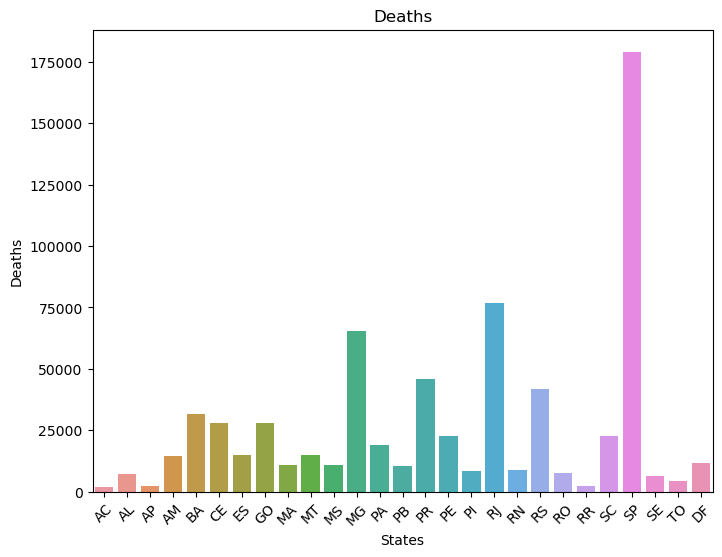

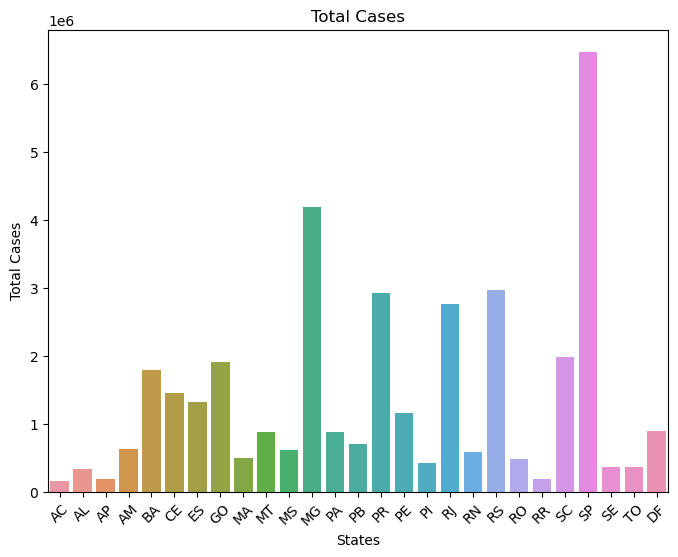

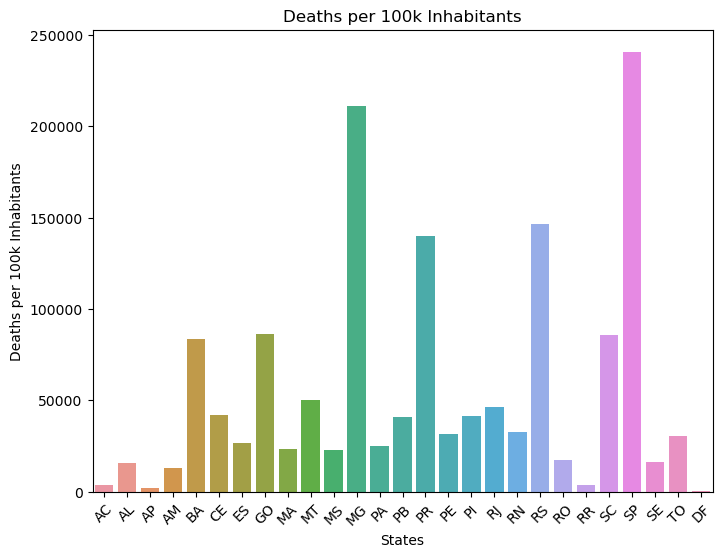

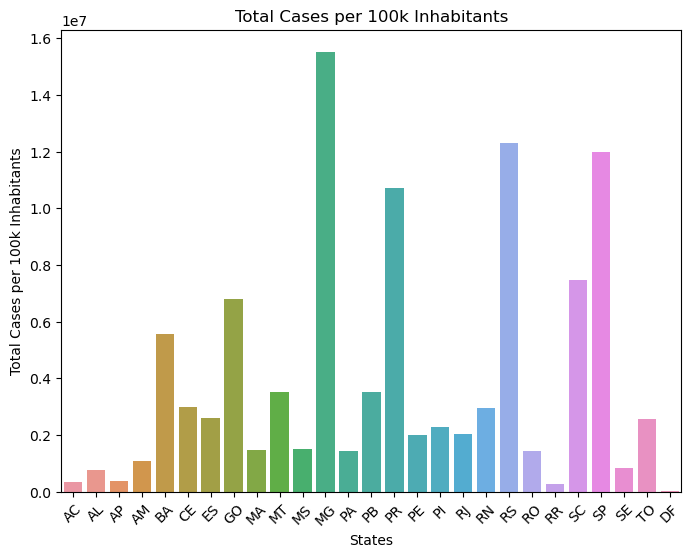

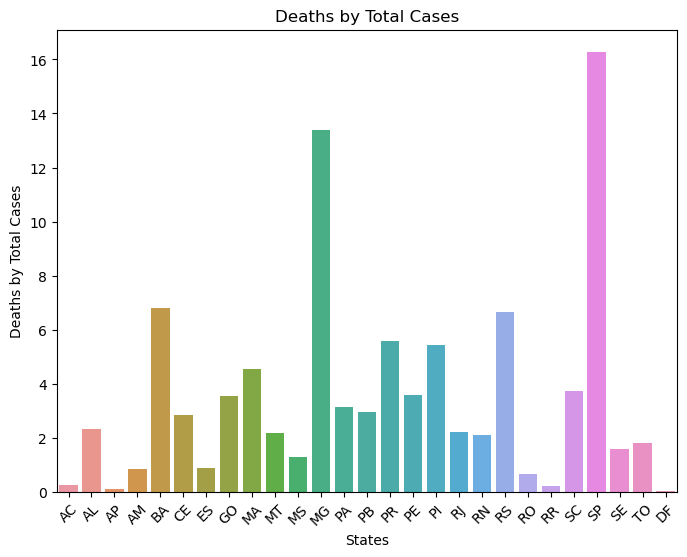

In [ ]:
# Set the first column as the x-axis for all charts
x_values = df_by_state['States']

# Plot a chart for each column except the first one
for column in df_by_state.columns[2:]:
    plt.figure(figsize=(8, 6))
    sns.barplot(x=x_values, y=df_by_state[column])
    plt.title(f'{column}')
    plt.xlabel('States')
    plt.ylabel(f'{column}')
    plt.xticks(rotation=45)
    plt.show()

2. In this part for showing the number of deaths by region and important infomations in data in Brazil, create a piechart.

#### Now show the total number of <code>Regiones</code> across the <code>Deaths</code>, <code>Total Cases</code>, <code>Deaths by Total Cases</code>,and <code>Total Cases per 100k Inhabitants</code> with <code>Pie chart</code>. Explain what you can understand from the figures.

***Note1***: Use the dataframe that you made from the <code>regions</code> dictionary.

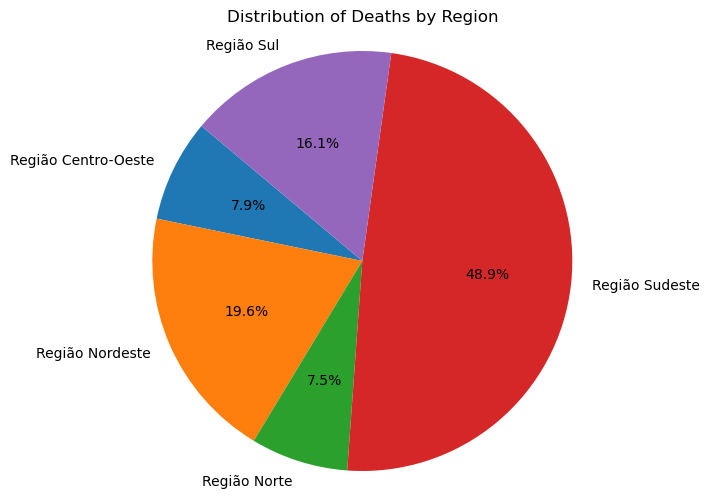

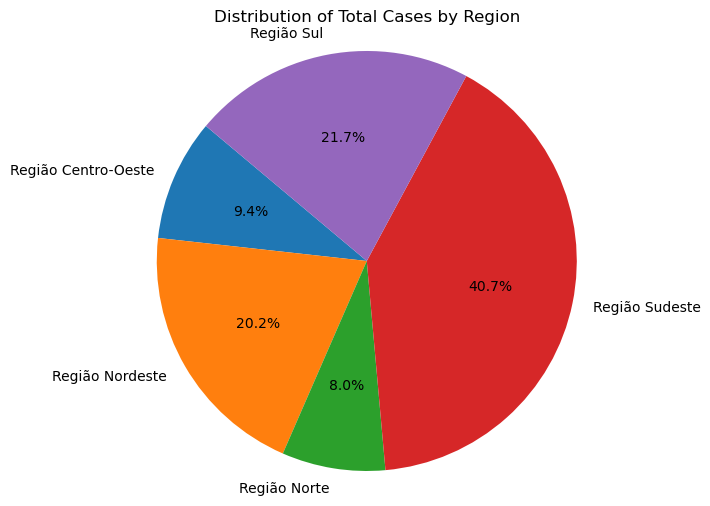

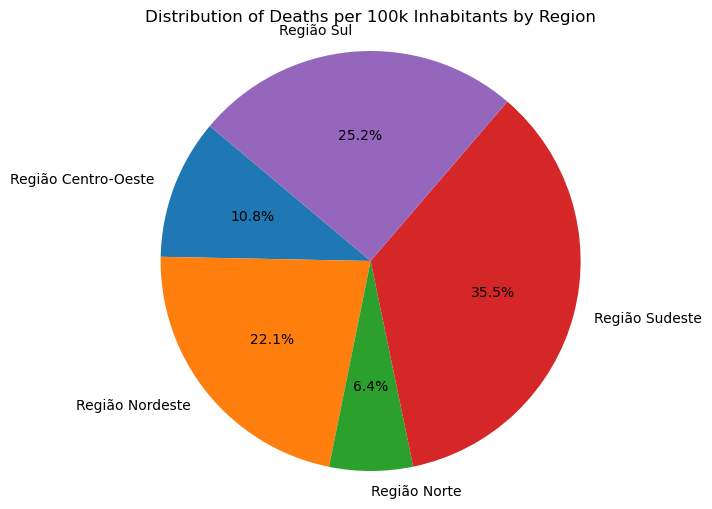

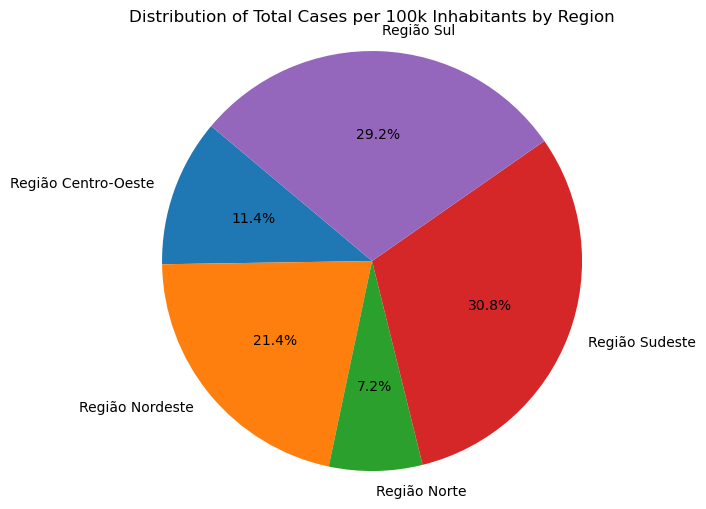

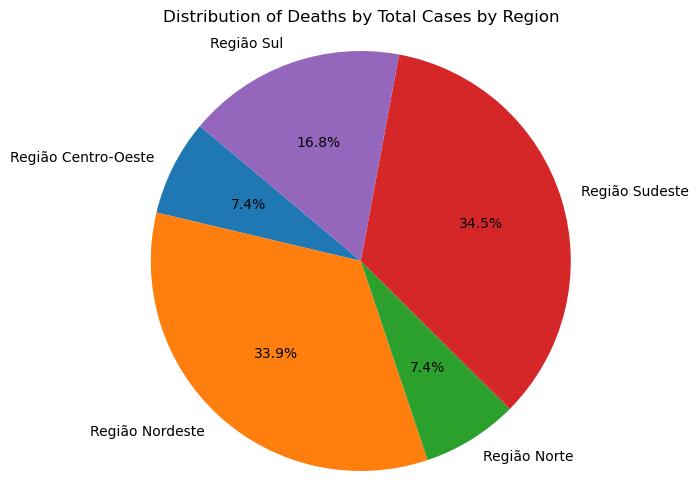

In [ ]:
# In[ ] Data Visualization Piechart

# Create a pie chart
for column in df_by_region_grouped.columns[1:]:
    plt.figure(figsize=(8, 6))
    plt.pie(df_by_region_grouped[column], labels=df_by_region_grouped['Region'], autopct='%1.1f%%', startangle=140)
    plt.title(f'Distribution of {column} by Region')
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()

# Show the pie chart
plt.show()

## tree map analysis

#### Now plot the <code>Deaths</code>, <code>Total Cases</code>, <code>Deaths by Total Cases</code>,and <code>Total Cases per 100k Inhabitants</code> figures.

***Note***: Use the dataframe that you made from the <code>state_names</code> dictionary

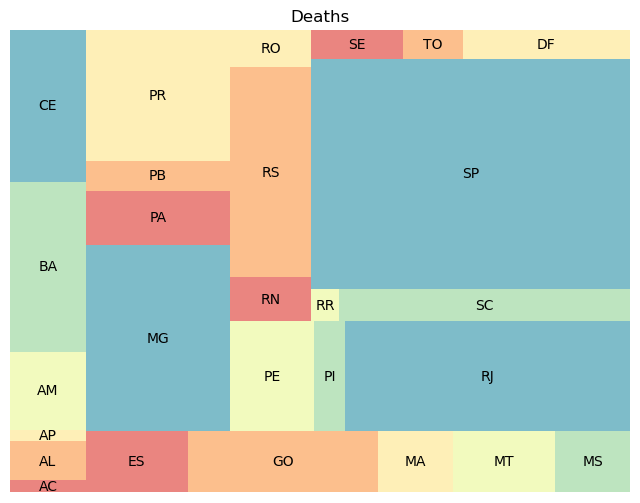

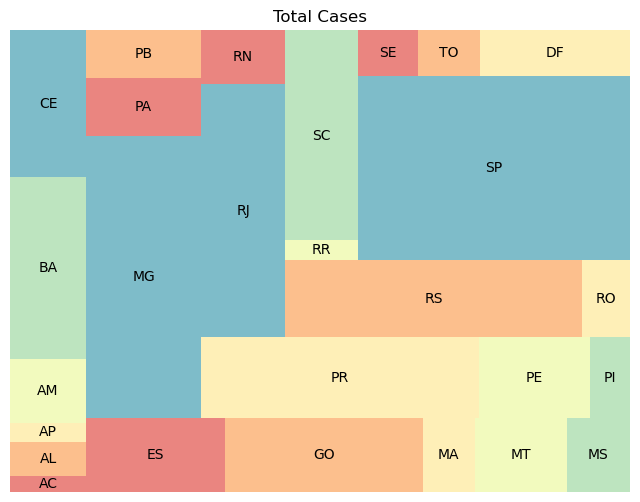

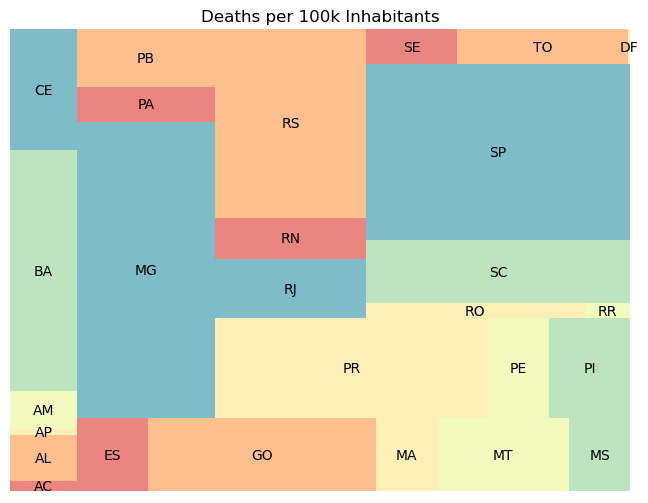

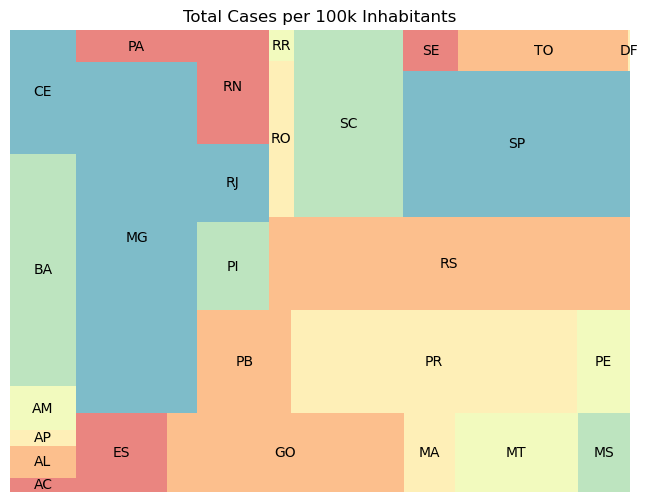

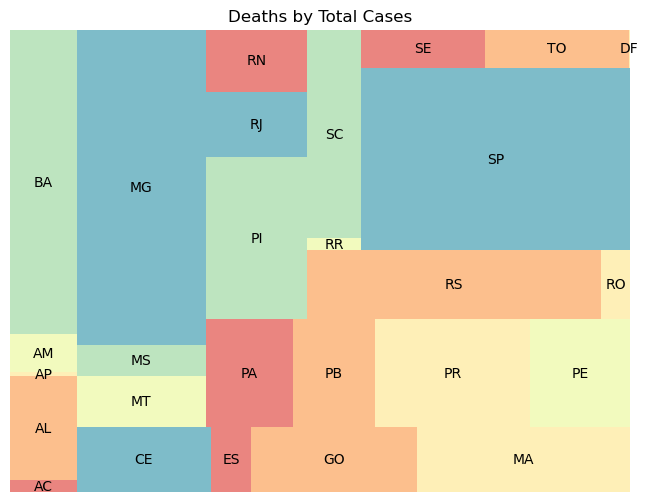

In [ ]:
for column in df_by_state.columns[2:]:
    plt.figure(figsize=(8, 6))

    values = df_by_state[column].values
    labels = df_by_state.index
    state_abbr = [abbr for abbr in df_by_state['States']]

    colors = sns.color_palette("Spectral")[0:len(values)]

    squarify.plot(sizes=values, label=state_abbr, color= colors, alpha=0.7)

    plt.title(f'{column}')
    plt.axis('off')

    plt.show()

## GADM
#### <code>GADM</code> is a free resource to use for non-commercial and research purposes that provides data for mapping administrative boundaries. Use <code>GADM</code> to show important information of data by using the map of Brazil.

***Note1***: Read the shapefile data of Brazil by <code>gpd</code> library.

***Note2***: Rename the column to merge the dataset(columns={'NAME_1': 'State Names'}).

***Note3***: Merge the population data with the GeoDataFrame (with the dataframe that you made with <code>State Names</code>).



In [ ]:
# Read the shapefile data
uf_br = gpd.read_file('world data/data/gadm36_BRA_1.shp')
uf_br_geo = uf_br[['NAME_1', 'geometry']]

# Rename the column to merge the dataset
uf_br_geo.rename(columns={'NAME_1': 'State Names'}, inplace=True)

# Merge the population data with the GeoDataFrame
merged_df = uf_br_geo.merge(df_by_state, on='State Names')

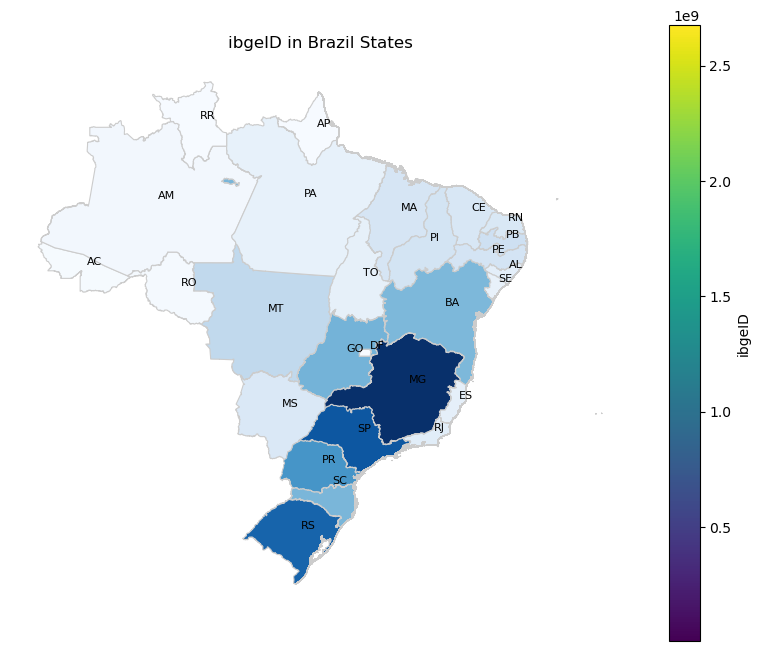

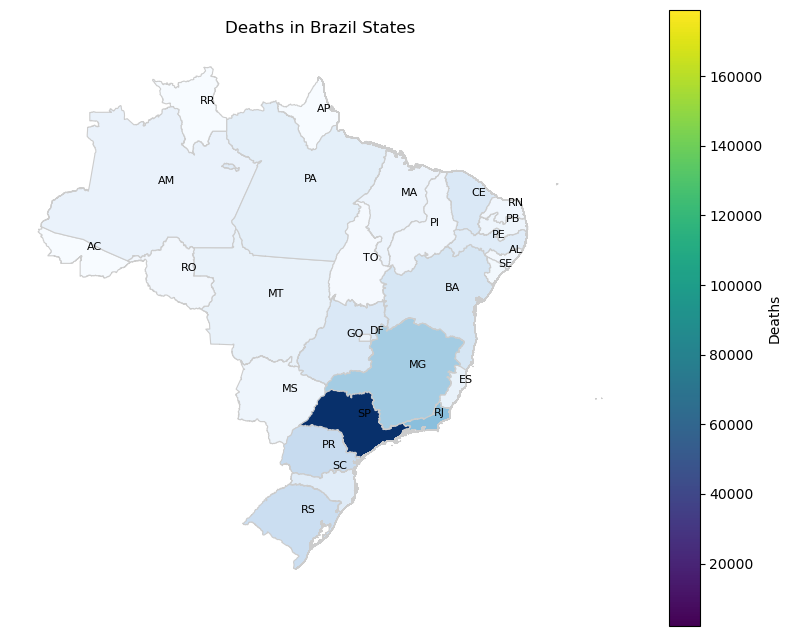

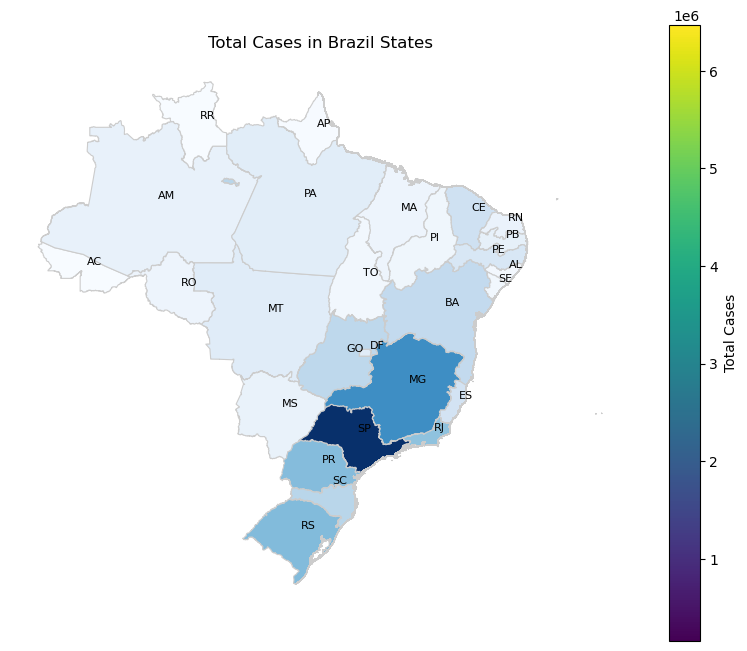

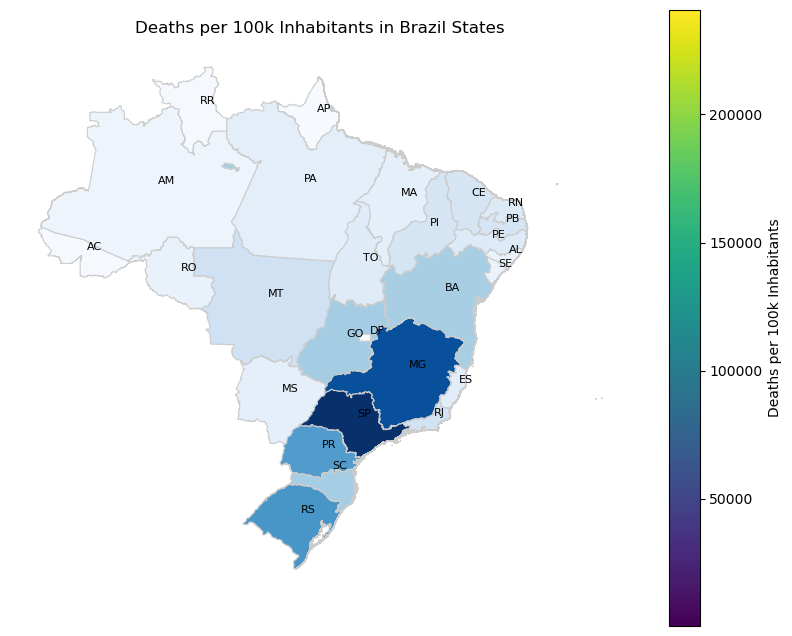

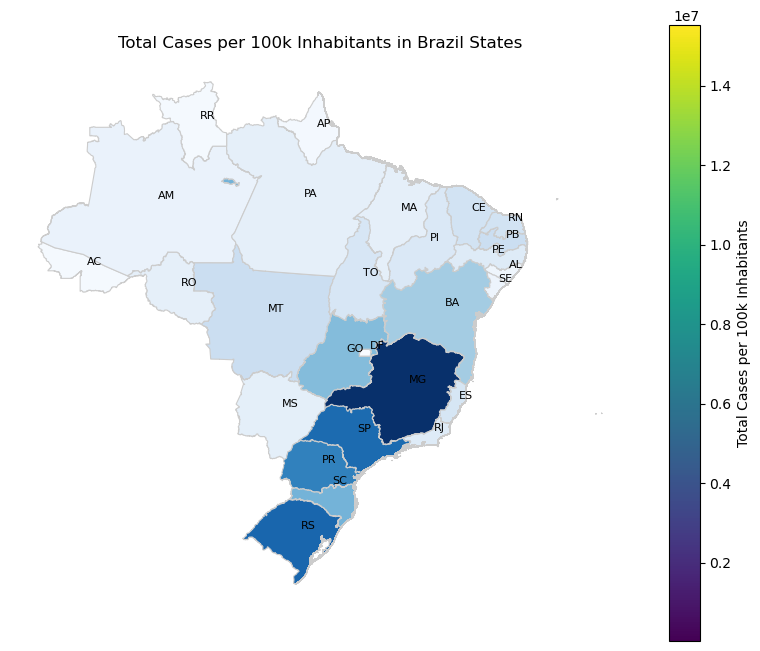

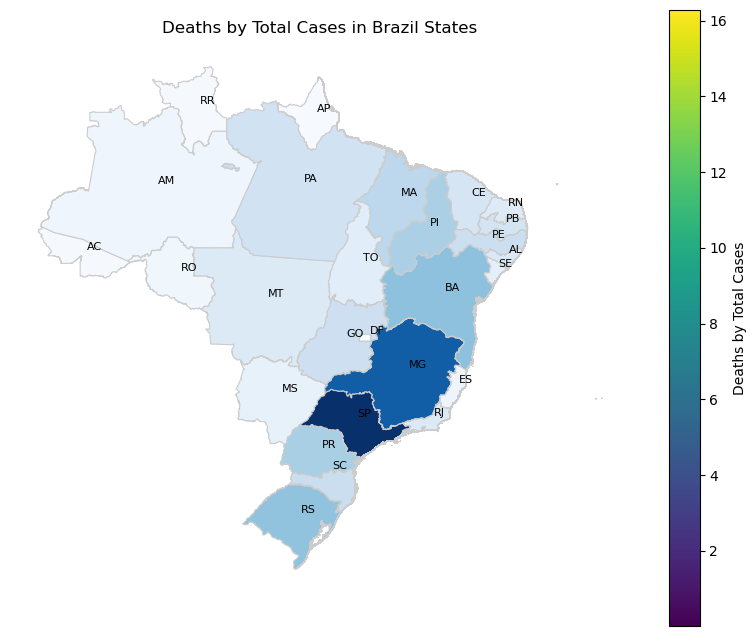

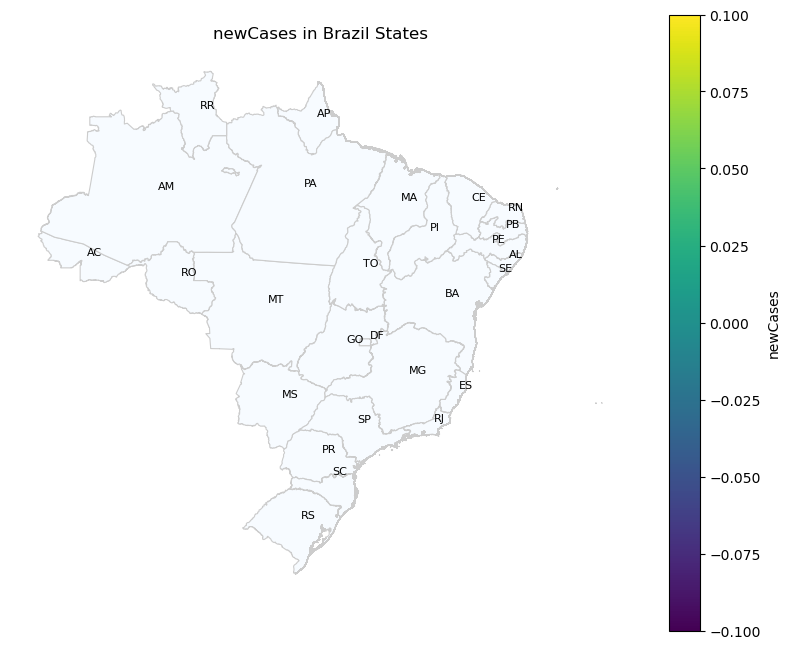

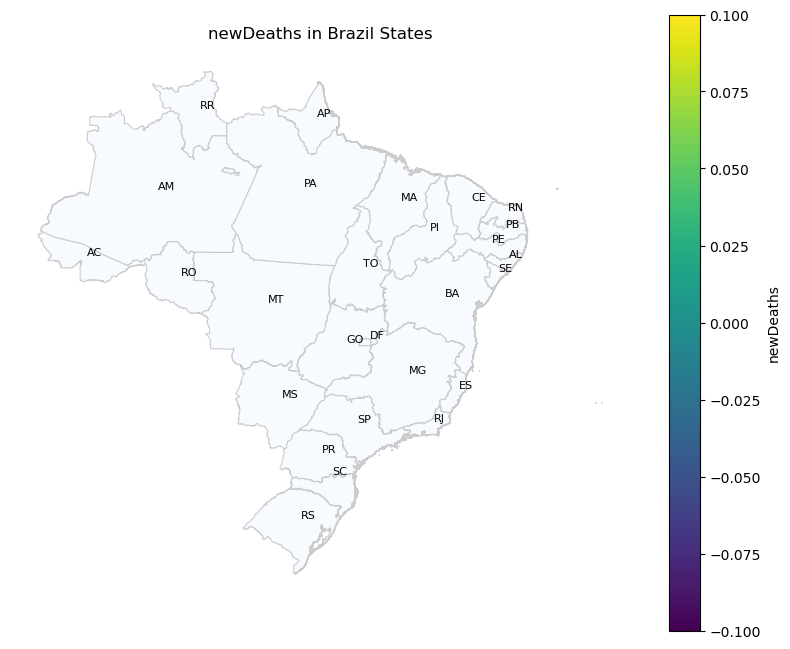

In [ ]:
# Iterate through each column (excluding non-numeric columns)
for column in merged_df.columns:
    if column not in ['States', 'State Names', 'geometry']:
        # Normalize population values between 0 and 1 for coloring
        col_min = merged_df[column].min()
        col_max = merged_df[column].max()
        norm = Normalize(vmin=col_min, vmax=col_max)

        # Create a scalar mappable to apply colormap to the map
        sm = ScalarMappable( norm=norm)
        sm.set_array([])  # dummy array for the scalar mappable

        # Plot the map with the colored regions
        fig, ax = plt.subplots(1, 1, figsize=(10, 8))
        merged_df.plot(column=column, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')
        ax.set_title(f'{column} in Brazil States')
        ax.set_axis_off()

        # Loop through the rows of the DataFrame to annotate state abbreviations
        for idx, row in merged_df.iterrows():
            state_abbr = row['States']
            state_geometry = row['geometry']

            # Get the centroid of the state geometry
            centroid = state_geometry.centroid

            # Annotate the abbreviation at the centroid
            ax.annotate(text=state_abbr, xy=(centroid.x, centroid.y), xytext=(3, 3),
                        textcoords="offset points", color='black', fontsize=8)


        # Create colorbar
        cbar = fig.colorbar(sm, ax=ax)
        cbar.set_label(column)

        # Save or show the map
        plt.savefig(f'{column}_map.png')  # Save the figure as an image
        plt.show()  # Display the figure